<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"></ul></div>

This notebook builds on the regular SmithEstimator object by incorporating the `jumpparcels` dataset in addition to the `environparcels`. It's not completely functional, but has working code to incorporate the additional dataset and calculate jump participating parcels from across both. If working with both datasets together is of interest to Morgan, Paco can and should extract the valuable parts of this which should get her started on that.

In [5]:
import numpy as np
import pandas as pd
import netCDF4 as nc4
from netCDF4 import Dataset
#import cmocean
import xarray as xr
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from matplotlib.colors import ListedColormap, BoundaryNorm
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from scipy.integrate import cumtrapz
import plotly
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode
import plotly.express as px

In [6]:
xenv = np.load('environparcels/x.npy')
yenv = np.load('environparcels/y.npy')
zenv = np.load('environparcels/z.npy')
uenv = np.load('environparcels/u.npy')
venv = np.load('environparcels/v.npy')
wenv = np.load('environparcels/w.npy')
thetaenv = np.load('environparcels/theta.npy')
presenv = np.load('environparcels/pres.npy')
rhoenv = np.load('environparcels/rho.npy')

speedenv = np.sqrt(uenv**2 + venv**2 + wenv**2)


xjump = np.load('jumpparcels/xj.npy')
yjump = np.load('jumpparcels/yj.npy')
zjump = np.load('jumpparcels/zj.npy')
ujump = np.load('jumpparcels/uj.npy')
vjump = np.load('jumpparcels/vj.npy')
wjump = np.load('jumpparcels/wj.npy')
thetajump = np.load('jumpparcels/thetaj.npy')
presjump = np.load('jumpparcels/presj.npy')
rhojump = np.load('jumpparcels/rhoj.npy')


speedjump = np.sqrt(ujump**2 + vjump**2 + wjump**2)

In [9]:
df = px.data.gapminder()
df_2007 = df.query("year==2007")
template = 'plotly_white'

colmax = 110 # [m/s]
colmin = 0   # [m/s]
# colmax = 450 # [K]
# colmin = 330  # [K]
# colmax = 150 # [kPa]
# colmin = -100  # [kPa]
# colmax = 250 # [kPa]
# colmin = 0  # [kPa]
msize = 0.5

t1 = 2
t2 = 1800
skipt = 4

fig = go.Figure()

#env parcels
for ind in range(0,xenv.shape[1],100):
    scatvar = speedenv[t1:t2:skipt,ind]
#         scatvar = thetaenv[t1:t2:skipt,ind]
#         scatvar = presenv[t1:t2:skipt,ind].copy()
#         scatvar -= presenv[t1,ind] + rhoenv[t1:t2:skipt,ind] * 9.81 * (zenv[t1:t2:skipt,ind] - zenv[t1, ind])
#         scatvar /= 100
#         scatvar = presenv[t1:t2:skipt,ind] / 100
    fig.add_trace(go.Scatter3d(
        x=xenv[t1:t2:skipt,ind]/1000.+121,
        y=yenv[t1:t2:skipt,ind]/1000.+55,
        z=zenv[t1:t2:skipt,ind]/1000.,
        mode='markers',
        marker= dict(
            size=msize,
            color=scatvar,
            colorscale='Viridis',
            cmin=colmin,cmax=colmax,
#             colorbar=dict(title='Potential temperature [K]',thickness=15)
#                 colorbar=dict(title='Pressure [hPa]',thickness=15)
            colorbar=dict(title='Windspeed [m/s]',thickness=15)
        ),
        projection=dict(x=dict(show=True,opacity=0.1),z=dict(show=True,opacity=0.1))
    ))

# jump parcels

for ind in range(0,xjump.shape[1], 200):
    
#     if (
#         (xjump[t1,ind]/1000 + 121 < 50)
#         and (speedjump[t1:t2,ind].max() >80)
#         and (np.random.rand() < 0.25)
#     ):

#     scatvar = thetajump[t1:t2:skipt,ind]
    scatvar = speedjump[t1:t2:skipt,ind]
#         scatvar = presjump[t1:t2:skipt,ind].copy()
#         scatvar -= presjump[t1,ind] + rhojump[t1:t2:skipt,ind] * 9.81 * (zjump[t1:t2:skipt,ind] - zjump[t1, ind])
#         scatvar /= 100

    fig.add_trace(go.Scatter3d(
    x=xjump[t1:t2:skipt,ind]/1000.+121,y=yjump[t1:t2:skipt,ind]/1000.+55,z=zjump[t1:t2:skipt,ind]/1000.,mode='markers',marker= dict(
        size=msize,
        color=scatvar,#opacity=0.8,
        colorscale='Viridis',
        cmin=colmin,cmax=colmax,
        #showscale=True,
#             colorbar=dict(title='Pressure [hPa]',thickness=15)),
        colorbar=dict(title='Windspeed [m/s]',thickness=15)),
            projection=dict(
             x=dict(show=True,opacity=0.1),
             z=dict(show=True,opacity=0.1))))


fig.update_layout(#title = '3D Scatter plot of parcels that reach windspeed>%.f m/s'%thresh,
    template=template,
    showlegend=False,
    width=950,height=700,
    scene=dict(camera=dict(up=dict(x=0, y=0, z=1),
                        center=dict(x=0, y=0, z=0),
                        eye=dict(x=0.06,y=-2.3,z=0.51)),
        xaxis=dict(title='East [km]'),yaxis=dict(title='North [km]'),zaxis=dict(title='Altitude [km]'),
        aspectmode='data'))

# fig.write_html('jump_windspeed.html')
# fig.write_image("fig2A.pdf")
iplot(fig)



In [60]:
# SHOW fast under slow

df = px.data.gapminder()
df_2007 = df.query("year==2007")
template = 'plotly_white'

colmax = 110 # [m/s]
colmin = 0   # [m/s]
# colmax = 450 # [K]
# colmin = 330  # [K]
# colmax = 150 # [kPa]
# colmin = -100  # [kPa]
# colmax = 250 # [kPa]
# colmin = 0  # [kPa]
msize = 0.5

t1 = 2
t2 = 1800
skipt = 4

fig = go.Figure()

# #env parcels
# for ind in range(0,xenv.shape[1],2):
#     if speedjump[t1:t2,ind].max() >90:
#         scatvar = speedenv[t1:t2:skipt,ind]
# #         scatvar = thetaenv[t1:t2:skipt,ind]
# #         scatvar = presenv[t1:t2:skipt,ind].copy()
# #         scatvar -= presenv[t1,ind] + rhoenv[t1:t2:skipt,ind] * 9.81 * (zenv[t1:t2:skipt,ind] - zenv[t1, ind])
# #         scatvar /= 100
# #         scatvar = presenv[t1:t2:skipt,ind] / 100
#         fig.add_trace(go.Scatter3d(
#             x=xenv[t1:t2:skipt,ind]/1000.+121,
#             y=yenv[t1:t2:skipt,ind]/1000.+55,
#             z=zenv[t1:t2:skipt,ind]/1000.,
#             mode='markers',
#             marker= dict(
#                 size=msize*2,
#                 color=scatvar,
#                 colorscale='Viridis',
#                 cmin=colmin,cmax=colmax,
#     #             colorbar=dict(title='Potential temperature [K]',thickness=15)
# #                 colorbar=dict(title='Pressure [hPa]',thickness=15)
#                 colorbar=dict(title='Windspeed [m/s]',thickness=15)
#             ),
#             projection=dict(x=dict(show=True,opacity=0.1),z=dict(show=True,opacity=0.1))
#         ))
    

# jump parcels

keepers = []

for ind in range(0,xjump.shape[1]):
    
    if (
        (speedjump[t1:t2,ind].max() >0)
        and (xjump[t1,ind]/1000 + 121 < 50)
        and (speedjump[t1:t2,ind].max() <80)
        and (np.random.rand() < 0.5)
    ):
        keepers.append(ind)

    #     scatvar = thetajump[t1:t2:skipt,ind]
        scatvar = speedjump[t1:t2:skipt,ind]
#         scatvar = presjump[t1:t2:skipt,ind].copy()
#         scatvar -= presjump[t1,ind] + rhojump[t1:t2:skipt,ind] * 9.81 * (zjump[t1:t2:skipt,ind] - zjump[t1, ind])
#         scatvar /= 100

        fig.add_trace(go.Scatter3d(
        x=xjump[t1:t2:skipt,ind]/1000.+121,y=yjump[t1:t2:skipt,ind]/1000.+55,z=zjump[t1:t2:skipt,ind]/1000.,mode='markers',marker= dict(
            size=msize,
            color=scatvar,#opacity=0.8,
            colorscale='Viridis',
            cmin=colmin,cmax=colmax,
            #showscale=True,
#             colorbar=dict(title='Pressure [hPa]',thickness=15)),
            colorbar=dict(title='Windspeed [m/s]',thickness=15)),
                projection=dict(
                 x=dict(show=True,opacity=0.1),
                 z=dict(show=True,opacity=0.1))))

skipt=2
for ind in range(0,xjump.shape[1]):
    
    if (
        (speedjump[t1:t2,ind].max() >110)
        and (xjump[t1,ind]/1000 + 121 < 50)
        and (np.random.rand() < 0.5)
#         and (speedjump[t1:t2,ind].max() <80)
    ):

    #     scatvar = thetajump[t1:t2:skipt,ind]
        scatvar = speedjump[t1:t2:skipt,ind]
#         scatvar = presjump[t1:t2:skipt,ind].copy()
#         scatvar -= presjump[t1,ind] + rhojump[t1:t2:skipt,ind] * 9.81 * (zjump[t1:t2:skipt,ind] - zjump[t1, ind])
#         scatvar /= 100

        fig.add_trace(go.Scatter3d(
        x=xjump[t1:t2:skipt,ind]/1000.+121,y=yjump[t1:t2:skipt,ind]/1000.+55,z=zjump[t1:t2:skipt,ind]/1000.,mode='markers',marker= dict(
            size=msize,
            color=scatvar,#opacity=0.8,
            colorscale='thermal',
            cmin=colmin,cmax=colmax,
            #showscale=True,
#             colorbar=dict(title='Pressure [hPa]',thickness=15)),
            colorbar=dict(title='Windspeed [m/s]',thickness=15)),
                projection=dict(
                 x=dict(show=True,opacity=0.1),
                 z=dict(show=True,opacity=0.1))))



fig.update_layout(#title = '3D Scatter plot of parcels that reach windspeed>%.f m/s'%thresh,
    template=template,
    showlegend=False,
    width=950,height=700,
    scene=dict(camera=dict(up=dict(x=0, y=0, z=1),
                        center=dict(x=0, y=0, z=0),
                        eye=dict(x=0.06,y=-2.3,z=0.51)),
        xaxis=dict(title='East [km]'),yaxis=dict(title='North [km]'),zaxis=dict(title='Altitude [km]'),
        aspectmode='data'))

# fig.write_html('jump_windspeed.html')
# fig.write_image("fig2A.pdf")
iplot(fig)



In [7]:
# df = px.data.gapminder()
# df_2007 = df.query("year==2007")
# template = 'plotly_white'

# # colmax = 110 # [m/s]
# # colmin = 0   # [m/s]
# # colmax = 450 # [K]
# # colmin = 330  # [K]
# # colmax = 150 # [kPa]
# # colmin = -100  # [kPa]
# colmax = 250 # [kPa]
# colmin = 0  # [kPa]
# msize = 0.5

# t1 = 2
# t2 = 1800
# skipt = 2

# fig = go.Figure()

# # #env parcels
# # for ind in range(0,xenv.shape[1],2):
# #     if speedjump[t1:t2,ind].max() >90:
# # #         scatvar = speedenv[t1:t2:skipt,ind]
# # #         scatvar = thetaenv[t1:t2:skipt,ind]
# # #         scatvar = presenv[t1:t2:skipt,ind].copy()
# # #         scatvar -= presenv[t1,ind] + rhoenv[t1:t2:skipt,ind] * 9.81 * (zenv[t1:t2:skipt,ind] - zenv[t1, ind])
# # #         scatvar /= 100
# #         scatvar = presenv[t1:t2:skipt,ind] / 100
# #         fig.add_trace(go.Scatter3d(
# #             x=xenv[t1:t2:skipt,ind]/1000.+121,
# #             y=yenv[t1:t2:skipt,ind]/1000.+55,
# #             z=zenv[t1:t2:skipt,ind]/1000.,
# #             mode='markers',
# #             marker= dict(
# #                 size=msize*2,
# #                 color=scatvar,
# #                 colorscale='thermal',
# #                 cmin=colmin,cmax=colmax,
# #     #             colorbar=dict(title='Potential temperature [K]',thickness=15)
# #                 colorbar=dict(title='Pressure [hPa]',thickness=15)
# # #                 colorbar=dict(title='Windspeed [m/s]',thickness=15)
# #             ),
# #             projection=dict(x=dict(show=True,opacity=0.1),z=dict(show=True,opacity=0.1))
# #         ))
    

# # # jump parcels

# for ind in range(0,xjump.shape[1],10):
    
#     if abs(zjump[t1+1,ind] - zjump[t1,ind]) <1:

#     #     scatvar = thetajump[t1:t2:skipt,ind]
# #         scatvar = speedjump[t1:t2:skipt,ind]
#         scatvar = presjump[t1:t2:skipt,ind].copy()
# #         scatvar -= presjump[t1,ind] + rhojump[t1:t2:skipt,ind] * 9.81 * (zjump[t1:t2:skipt,ind] - zjump[t1, ind])
#         scatvar /= 100

#         fig.add_trace(go.Scatter3d(
#         x=xjump[t1:t2:skipt,ind]/1000.+121,y=yjump[t1:t2:skipt,ind]/1000.+55,z=zjump[t1:t2:skipt,ind]/1000.,mode='markers',marker= dict(
#             size=msize,
#             color=scatvar,#opacity=0.8,
#             colorscale='Viridis',
#             cmin=colmin,cmax=colmax,
#             #showscale=True,
#             colorbar=dict(title='Pressure [hPa]',thickness=15)),
# #             colorbar=dict(title='Windspeed [m/s]',thickness=15)),
#                 projection=dict(
#                  x=dict(show=True,opacity=0.1),
#                  z=dict(show=True,opacity=0.1))))



# fig.update_layout(#title = '3D Scatter plot of parcels that reach windspeed>%.f m/s'%thresh,
#     template=template,
#     showlegend=False,
#     width=950,height=700,
#     scene=dict(camera=dict(up=dict(x=0, y=0, z=1),
#                         center=dict(x=0, y=0, z=0),
#                         eye=dict(x=0.06,y=-2.3,z=0.51)),
#         xaxis=dict(title='East [km]'),yaxis=dict(title='North [km]'),zaxis=dict(title='Altitude [km]'),
#         aspectmode='data'))

# # fig.write_html('jump_windspeed.html')
# # fig.write_image("fig2A.pdf")
# iplot(fig)



In [70]:
class SmithEstimator:    
    def __init__(
        self,
        x_env_data, # m
        y_env_data, # m
        z_env_data, # m
        u_env_data, # m/s
        v_env_data, # m/s
        w_env_data, # m/s
        theta_env_data, # K
        speed_env_data, # m/s
        pres_env_data, # Pa
        rho_env_data, # kg/m^3
        x_jump_data, # m
        y_jump_data, # m
        z_jump_data, # m
        u_jump_data, # m/s
        v_jump_data, # m/s
        w_jump_data, # m/s
        theta_jump_data, # K
        speed_jump_data, # m/s
        pres_jump_data, # Pa
        rho_jump_data # kg/m^3
    ):
        flat_ind = self.__get_flat_y_ind(y_env_data[1:-1])
        
        # drop the first and last time-step because theta is zero everywhere for some reason
        # other transformations taken from Morgan's code
        
        self.x_data = pd.DataFrame(
            x_env_data[1:-1, flat_ind] + 121000,
            index=pd.Index(range(1,len(x_env_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.y_data = pd.DataFrame(
            y_env_data[1:-1, flat_ind] + 55000,
            index=pd.Index(range(1,len(y_env_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )

        self.z_data = pd.DataFrame(
            z_env_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(z_env_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.u_data = pd.DataFrame(
            u_env_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(u_env_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.v_data = pd.DataFrame(
            v_env_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(v_env_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.w_data = pd.DataFrame(
            w_env_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(w_env_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.theta_data = pd.DataFrame(
            theta_env_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(theta_env_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.speed_data = pd.DataFrame(
            speed_env_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(speed_env_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.pres_data = pd.DataFrame(
            pres_env_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(pres_env_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.rho_data = pd.DataFrame(
            rho_env_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(pres_env_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.x_data_jump_label = pd.DataFrame(
            x_jump_data[1:-1, flat_ind] + 121000,
            index=pd.Index(range(1,len(x_jump_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.y_data_jump_label = pd.DataFrame(
            y_jump_data[1:-1, flat_ind] + 55000,
            index=pd.Index(range(1,len(y_jump_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )

        self.z_data_jump_label = pd.DataFrame(
            z_jump_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(z_jump_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.u_data_jump_label = pd.DataFrame(
            u_jump_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(u_jump_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.v_data_jump_label = pd.DataFrame(
            v_jump_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(v_jump_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.w_data_jump_label = pd.DataFrame(
            w_jump_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(w_jump_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.theta_data_jump_label = pd.DataFrame(
            theta_jump_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(theta_jump_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.speed_data_jump_label = pd.DataFrame(
            speed_jump_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(speed_jump_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.pres_data_jump_label = pd.DataFrame(
            pres_jump_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(pres_jump_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.rho_data_jump_label = pd.DataFrame(
            rho_jump_data[1:-1, flat_ind],
            index=pd.Index(range(1,len(pres_jump_data) - 1), name='time_step'),
            columns=pd.Index(flat_ind, name='parcel_idx')
        )
        
        self.x_data_jump = pd.DataFrame()
        
        self.y_data_jump = pd.DataFrame()

        self.z_data_jump = pd.DataFrame()
        
        self.u_data_jump = pd.DataFrame()
        
        self.v_data_jump = pd.DataFrame()
        
        self.w_data_jump = pd.DataFrame()
        
        self.theta_data_jump = pd.DataFrame()
        
        self.speed_data_jump = pd.DataFrame()
        
        self.pres_data_jump = pd.DataFrame()
        
        self.rho_data_jump = pd.DataFrame()
                
    @staticmethod
    def __get_flat_y_ind(y_data):
        median_y = np.median(y_data[0])
        to_be_included = np.abs(y_data[0] - median_y) <= 1000
        return np.array(range(len(y_data[0])))[to_be_included]
    
    def get_delta_z(parcel_ind):
        parcel_x_data = self.x_data.loc[:,parcel_ind]
        delta_z = self.z_data.loc[:,parcel_ind] - self.z_data.loc[0,parcel_ind]
        return parcel_x_data, delta_z

    def get_h_and_displacement(self, hydraulic_jump_end_x=62):
        # calculate obstacle height from lowest jump parcel and top streamline displacement from top jump parcel
        
        self.populate_jump_parcels()
        
        d_parcel = self.z_data_jump.iloc[0].idxmax()  
        h_parcel = self.z_data_jump.iloc[0].idxmin()

        
        last_x = self.__get_left_x_index(self.x_data_jump[d_parcel], hydraulic_jump_end_x * 1000)
        matched_x_ind = self.match_parcels_by_x(self.x_data_jump.loc[:last_x, d_parcel], self.x_data_jump[h_parcel])
        d_xind = self.x_data_jump.loc[:last_x, d_parcel][[i is not None for i in matched_x_ind]].index
        h_xind = [i for i in matched_x_ind if i is not None]
        
        d_zdata = self.z_data_jump.loc[d_xind, d_parcel]
        delta_d = d_zdata - d_zdata.iloc[0]
        h_zdata = self.z_data_jump.loc[h_xind,h_parcel]
        delta_h = h_zdata - h_zdata.iloc[0]

        g = 9.81 # [m/s^2]
        H = self.z_data_jump[d_parcel].iloc[0] - self.z_data_jump[h_parcel].iloc[0] # [m]
        theta_env = self.theta_data_jump.iloc[0].mean() # [K]
        theta_gradient = (self.theta_data_jump[d_parcel].iloc[0] - self.theta_data_jump[h_parcel].iloc[0]) / H # [K/m]
        N = np.sqrt(g / theta_env * theta_gradient)
        
        u_0 = self.u_data_jump.iloc[0].mean() # [m/s]
        
        l = N / u_0
        print(f'scorer parameter: {l}')
        
        p_perturbations = (self.__get_p_perturbation(d_parcel) 
                           / self.rho_data_jump[d_parcel] / self.speed_data_jump.loc[1, d_parcel]**2)[:last_x]
        
        d_normed = delta_d * l
        h_normed = delta_h * l
        
        cos_term = np.cos(H * l + d_normed - h_normed)
        
        plt.scatter(h_normed[::5], d_normed[::5], s=1)
        plt.axvline(0, color='k')
        plt.axhline(0, color='k')
        
        smith_solution_1_3994_X = [0, -0.04, -0.08, -0.11, -0.15, -0.19, -0.24, -0.28, -0.32, -0.36, 
                                   -0.40, -0.45, -0.49, -0.53, -0.57, -0.62, -0.66, -0.71, -0.75, -0.80, 
                                   -0.84, -0.89, -0.93, -0.98, -1.02, -1.07, -1.11, -1.16, -1.20, -1.25, 
                                   -1.30, -1.34, -1.39, -1.43, -1.48, -1.53, -1.57, -1.62, -1.67, -1.71, 
                                   -1.76]
        smith_solution_1_3994_Y = np.linspace(0, -2, 41)
        
        plt.plot(smith_solution_1_3994_X, smith_solution_1_3994_Y, color='r')
        
        plt.xlabel('obstacle height h', fontsize=15)
        plt.ylabel('dividing streamline deflection \u03B4', fontsize=15)
#         plt.title(f'n(H_normed) = {((H * l) / (np.pi / 6))%12}')
        plt.title(f'H = {H * l}')
        plt.xlim([-2,None])
        plt.ylim([-2,None])
        
        return h_normed, d_normed, p_perturbations, cos_term, l, d_xind, d_parcel


    def populate_jump_parcels(self, slope_bottom_x=61.5, slope_top_x=55):
        # extracts jump parcels, defined as those that decrease monotonically through hydraulic jump and
        # and have u >> v 
    
        env_jump_parcels = []
        jump_jump_parcels = []
        for parcel in self.x_data.columns:
            parcel_data = self.x_data[parcel]
            slope_bottom = self.__get_left_x_index(parcel_data, slope_bottom_x * 1000)
            slope_top = self.__get_left_x_index(parcel_data, slope_top_x * 1000)
            if self._check_if_jump_parcel(parcel, parcel_data, slope_bottom):
                # require that parcels have u >> v
                if self.z_data.loc[slope_top:slope_bottom, parcel].is_monotonic_decreasing:
                    env_jump_parcels.append(parcel)
                    
        for parcel in self.x_data_jump_label.columns:
            parcel_data = self.x_data_jump_label[parcel]
            slope_bottom = self.__get_left_x_index(parcel_data, slope_bottom_x * 1000)
            if self._check_if_jump_parcel(parcel, parcel_data, slope_bottom):
                # require that parcels start left of 50km
                if self.x_data_jump_label.loc[1,parcel]/1000 < 50:
                    jump_jump_parcels.append(parcel)
                    
#         print(f'env min: {self.z_data.loc[1,env_jump_parcels].idxmin(), self.z_data.loc[1,env_jump_parcels].min()}')
#         print(f'jump min: {self.z_data_jump_label.loc[1,jump_jump_parcels].idxmin(), self.z_data_jump_label.loc[1,jump_jump_parcels].min()}')
#         print(f'env max: {self.z_data.loc[1,env_jump_parcels].idxmax(), self.z_data.loc[1,env_jump_parcels].max()}')
#         print(f'jump max: {self.z_data_jump_label.loc[1,jump_jump_parcels].idxmax(), self.z_data_jump_label.loc[1,jump_jump_parcels].max()}')
        

        for _, dataset_info in {'env':[env_jump_parcels, ''], 'jump':[jump_jump_parcels, '_jump_label']}.items():
            parcels = dataset_info[0]
            dataset = dataset_info[1]
            self.x_data_jump = pd.concat([
                self.x_data_jump, getattr(self, 'x_data'+dataset)[parcels]
            ],axis=1)
            
            self.y_data_jump = pd.concat([
                self.y_data_jump, getattr(self, 'y_data'+dataset)[parcels]
            ],axis=1)
            
            self.z_data_jump = pd.concat([
                self.z_data_jump, getattr(self, 'z_data'+dataset)[parcels]
            ],axis=1)
            
            self.u_data_jump = pd.concat([
                self.u_data_jump, getattr(self, 'u_data'+dataset)[parcels]
            ],axis=1)
            
            self.v_data_jump = pd.concat([
                self.v_data_jump, getattr(self, 'v_data'+dataset)[parcels]
            ],axis=1)
            
            self.w_data_jump = pd.concat([
                self.w_data_jump, getattr(self, 'w_data'+dataset)[parcels]
            ],axis=1)
            
            self.theta_data_jump = pd.concat([
                self.theta_data_jump, getattr(self, 'theta_data'+dataset)[parcels]
            ],axis=1)
            
            self.speed_data_jump = pd.concat([
                self.speed_data_jump, getattr(self, 'speed_data'+dataset)[parcels]
            ],axis=1)
            
            self.pres_data_jump = pd.concat([
                self.pres_data_jump, getattr(self, 'pres_data'+dataset)[parcels]
            ],axis=1)
            
            self.rho_data_jump = pd.concat([
                self.rho_data_jump, getattr(self, 'rho_data'+dataset)[parcels]
            ],axis=1)

    def _check_if_jump_parcel(self, parcel, parcel_data, slope_bottom, slope_top='not_given'):
        
        if (slope_bottom is None) or (slope_top is None):
            return False
        if (self.v_data.loc[:slope_bottom,parcel].abs() > 0.25*self.u_data.loc[:slope_bottom,parcel]).any():
            return False
        return True        
        
    @staticmethod
    def match_parcels_by_x(parcel_one, parcel_two):
        # Takes x-data for two parcels, the first already truncated before turbulent mixing
        # returns an indexer for parcel_two that aligns on x with parcel_one
        x_matched_two_index = []
        for x in parcel_one:
            x_matched_two_index.append(SmithEstimator.__get_left_x_index(parcel_two, x))
        return x_matched_two_index
    
    @staticmethod
    def __get_left_x_index(x_data, x_value):
        # only use this on one-to-one chunks of parcel paths
        candidates = x_data[x_data <= x_value]
        if candidates.empty or (x_value - max(candidates) > 1000): # if no x less than value or closest is far
            return None
        return candidates.last_valid_index()
    
    def __get_p_perturbation(self, parcel_idx):
        parcel_p = self.pres_data[parcel_idx]
        parcel_z = self.z_data[parcel_idx]
        delta_p = parcel_p - parcel_p[1]
        hydrostatic_change = self.rho_data[parcel_idx][1] * (parcel_z[1] - parcel_z) * 9.81
        return delta_p - hydrostatic_change
    
    def get_p_coefficient(self, parcel_idx):
        p_perturbation = self.__get(p_perturbation(parcel_idx))
        return p_perturbation
    
    def plot_parcel_data(self, parcel_idx, x_var, y_var):
        X = getattr(self, x_var)[parcel_idx]
        Y = getattr(self, y_var)[parcel_idx]
        plt.plot(X,Y)
    
    def plot_parcels(self, parcel_indices, color_var='speed'):
        
        if color_var=='speed':
            colmax = 50 # [m/s]
            colmin = 30   # [m/s]
            scatvar_data = self.speed_data
            title = 'Windspeed [m/s]'
      
        elif color_var=='theta':
            colmax = 450 # [K]
            colmin = 330  # [K]
            scatvar_data = self.theta_data
            title = 'Potential temperature [K]'
        elif color_var=='pres':
            colmax = 25000 # [Pa]
            colmin = 0 # [Pa]
            scatvar_data = self.pres_data
            title = 'Pressure [Pa]'
        else:
            raise RuntimeError(f'invalid color_var: {color_var}')
        
        df = px.data.gapminder()
        df_2007 = df.query("year==2007")
        template = 'plotly_white'

        
        msize = 0.5

        fig = go.Figure()

        for ind in parcel_indices:
            if (np.random.rand() < 0.5):
                scatvar = scatvar_data.loc[:,ind]
                fig.add_trace(go.Scatter3d(
                    x=self.x_data.loc[:,ind] / 1000.,
                    y=self.y_data.loc[:,ind] / 1000.,
                    z=self.z_data.loc[:,ind] / 1000.,
                    mode='markers',
                    marker= dict(
                        size=msize,
                        color=scatvar,
                        colorscale='Viridis',
                        cmin=colmin,cmax=colmax,
                        colorbar=dict(title=title,thickness=15)
                    ),
                    projection=dict(x=dict(show=True,opacity=0.1),z=dict(show=True,opacity=0.1))
                ))

        fig.update_layout(
            template=template,
            showlegend=False,
            width=950,height=700,
            scene=dict(
                camera=dict(
                    up=dict(x=0, y=0, z=1),
                    center=dict(x=0, y=0, z=0),
                    eye=dict(x=0.06,y=-2.3,z=0.51)
                ),
                xaxis=dict(title='East [km]'),
                yaxis=dict(title='North [km]'),
                zaxis=dict(title='Altitude [km]'),
                aspectmode='data'
            )
        )
        iplot(fig)
        
    def plot_jump_parcels(self, color_var='speed'):
        
        if color_var=='speed':
            colmax = 50 # [m/s]
            colmin = 30   # [m/s]
            scatvar_data = self.speed_data_jump
            title = 'Windspeed [m/s]'
      
        elif color_var=='theta':
            colmax = 450 # [K]
            colmin = 330  # [K]
            scatvar_data = self.theta_data_jump
            title = 'Potential temperature [K]'
        elif color_var=='pres':
            colmax = 25000 # [Pa]
            colmin = 0 # [Pa]
            scatvar_data = self.pres_data_jump
            title = 'Pressure [Pa]'
        else:
            raise RuntimeError(f'invalid color_var: {color_var}')
        
        df = px.data.gapminder()
        df_2007 = df.query("year==2007")
        template = 'plotly_white'

        
        msize = 0.5

        fig = go.Figure()

        for ind in self.x_data_jump.columns:
            if (np.random.rand() < 0.5):
                scatvar = scatvar_data.loc[::2,ind]
                fig.add_trace(go.Scatter3d(
                    x=self.x_data_jump.loc[::2,ind] / 1000.,
                    y=self.y_data_jump.loc[::2,ind] / 1000.,
                    z=self.z_data_jump.loc[::2,ind] / 1000.,
                    mode='markers',
                    marker= dict(
                        size=msize,
                        color=scatvar,
                        colorscale='Viridis',
                        cmin=colmin,cmax=colmax,
                        colorbar=dict(title=title,thickness=15)
                    ),
                    projection=dict(x=dict(show=True,opacity=0.1),z=dict(show=True,opacity=0.1))
                ))

        fig.update_layout(
            template=template,
            showlegend=False,
            width=950,height=700,
            scene=dict(
                camera=dict(
                    up=dict(x=0, y=0, z=1),
                    center=dict(x=0, y=0, z=0),
                    eye=dict(x=0.06,y=-2.3,z=0.51)
                ),
                xaxis=dict(title='East [km]'),
                yaxis=dict(title='North [km]'),
                zaxis=dict(title='Altitude [km]'),
                aspectmode='data'
            )
        )
        iplot(fig)

In [71]:
t = SmithEstimator(xenv, yenv, zenv, uenv, venv, wenv, thetaenv, speedenv, presenv, rhoenv,
                  xjump, yjump, zjump, ujump, vjump, wjump, thetajump, speedjump, presjump, rhojump)

In [14]:
t.plot_jump_parcels()

scorer parameter: 0.0006667936366463018


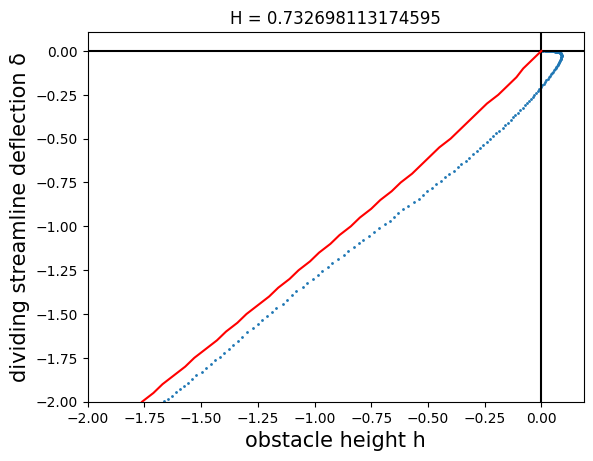

In [72]:
h, d, p_pert, cos_term, l, x_ind, x_parcel = t.get_h_and_displacement()

#three sig figs
smith_solution_1_3994_X = [-0.04, -0.08, -0.11, -0.15, -0.19, -0.24, -0.28, -0.32, -0.36, -0.40, 
                           -0.45, -0.49, -0.53, -0.57, -0.62, -0.66, -0.71, -0.75, -0.80, -0.84, 
                           -0.89, -0.93, -0.98, -1.02, -1.07, -1.11, -1.16, -1.20, -1.25, -1.30,
                          -1.34, -1.39, -1.43, -1.48, -1.53, -1.57, -1.62, -1.67, -1.71, -1.76]
smith_solution_1_3994_Y = np.linspace(0, -2, 41)

# deflection = (streamYsegments[163][:70] - streamYsegments[163][0]) * l
# h = (streamYsegments[182][:70] - streamYsegments[182][0]) * l
# plt.plot(h, deflection)
# plt.xlim([-2, 0.5])
# print(f'n(H_0) for time snaptshot streamfunctions is {(streamYsegments[163][0] - streamYsegments[182][0]) * l}')

Text(0, 0.5, 'height (normalized)')

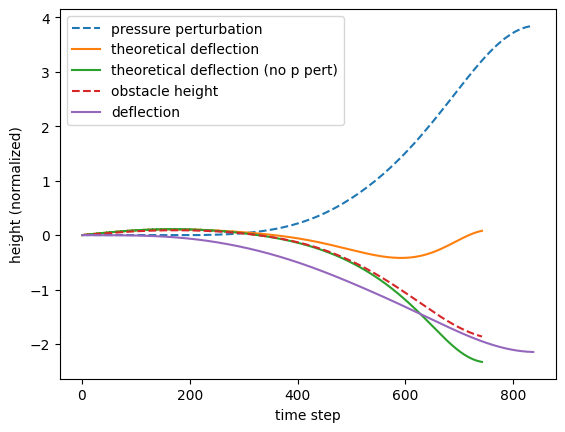

In [73]:
plt.plot(p_pert, '--', label='pressure perturbation')
plt.plot(h / cos_term + p_pert * (np.sqrt(cos_term**(-2) - 1)), label='theoretical deflection')
plt.plot(h / cos_term, label='theoretical deflection (no p pert)')
plt.plot(h, '--', label='obstacle height')
plt.plot(d, label='deflection')
# plt.plot(cos_term, '--', label='cos_term')
plt.legend()
plt.xlabel('time step')
plt.ylabel('height (normalized)')

In [6]:
jump_parcels = t.get_jump_parcels()

In [7]:
top, bottom = t.z_data.iloc[0][jump_parcels].idxmax(), t.z_data.iloc[0][jump_parcels].idxmin()

In [10]:
bottom

5073

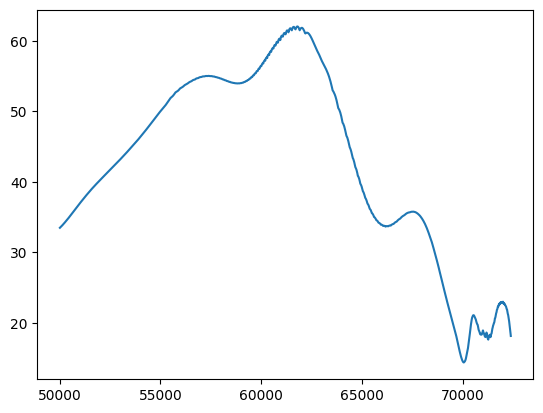

In [11]:
t.plot_parcel_data(5073, 'x_data', 'u_data')

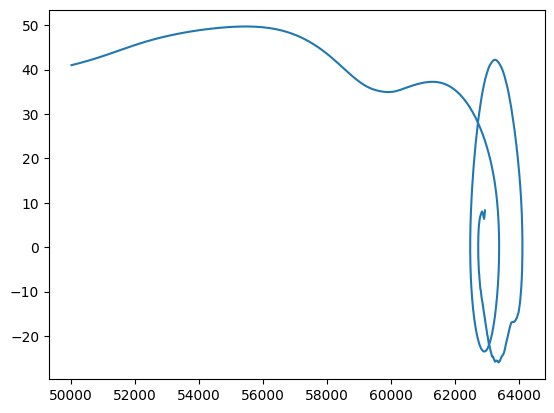

In [9]:
t.plot_parcel_data(5073, 'x_data', 'u_data')

In [ ]:
# t.plot_parcels([top, bottom], color_var='speed')

In [ ]:
# t.plot_parcels([top, bottom], color_var='speed')

In [ ]:
# t.plot_parcels(t.get_jump_parcels())

Text(0, 0.5, 'z position')

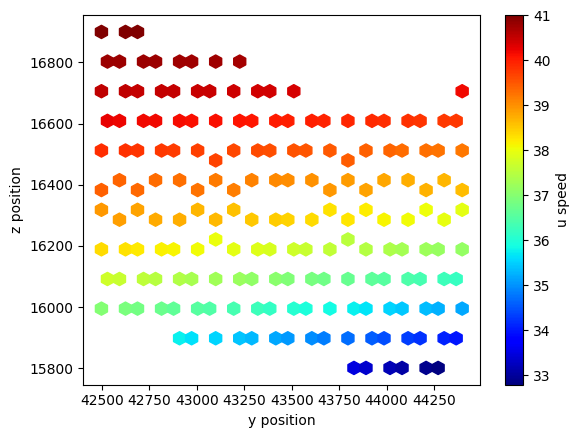

In [74]:
from matplotlib import pyplot as PLT
from matplotlib import cm as CM
from matplotlib import mlab as ML
import numpy as NP

# before adding t.var_jump stuff
# Y = t.y_data.loc[1, jump_parcels]
# Z = t.z_data.loc[1, jump_parcels]
# u = t.u_data.loc[1, jump_parcels]
# v = t.v_data.loc[1, jump_parcels]
# w = t.w_data.loc[1, jump_parcels]

Y = t.y_data_jump.loc[1]
Z = t.z_data_jump.loc[1]
u = t.u_data_jump.loc[1]
v = t.v_data_jump.loc[1]
w = t.w_data_jump.loc[1]

plt.hexbin(Y,Z, C=u, gridsize=30, cmap=CM.jet)
cb = PLT.colorbar()
cb.set_label('u speed')
plt.xlabel('y position')
plt.ylabel('z position')

Text(0, 0.5, 'z position')

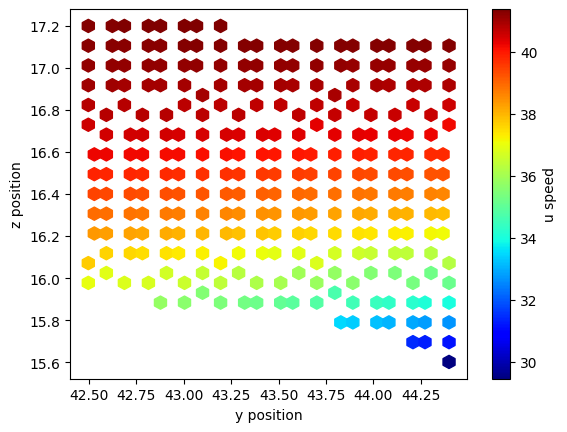

In [13]:
from matplotlib import pyplot as PLT
from matplotlib import cm as CM
from matplotlib import mlab as ML
import numpy as NP

# before adding t.var_jump stuff
# Y = t.y_data.loc[1, jump_parcels]
# Z = t.z_data.loc[1, jump_parcels]
# u = t.u_data.loc[1, jump_parcels]
# v = t.v_data.loc[1, jump_parcels]
# w = t.w_data.loc[1, jump_parcels]

Y = t.y_data_jump.loc[1]
Z = t.z_data_jump.loc[1]
u = t.u_data_jump.loc[1]
v = t.v_data_jump.loc[1]
w = t.w_data_jump.loc[1]

plt.hexbin(Y,Z, C=u, gridsize=30, cmap=CM.jet)
cb = PLT.colorbar()
cb.set_label('u speed')
plt.xlabel('y position')
plt.ylabel('z position')

Text(0, 0.5, 'z position')

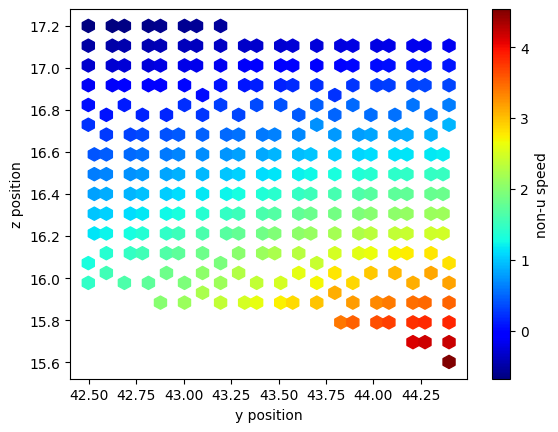

In [15]:
# plt.hexbin(Y,Z, C=np.sqrt(v**2 + w**2), gridsize=30, cmap=CM.jet)
plt.hexbin(Y,Z, C=w, gridsize=30, cmap=CM.jet)
cb = PLT.colorbar()
cb.set_label('non-u speed')
plt.xlabel('y position')
plt.ylabel('z position')

In [85]:
def get_next_down(parcel_idx, dataset):
    if dataset[parcel_idx] is None:
        return None
    lowers = dataset[Z < Z[parcel_idx] - 0.01]
    if lowers.empty or pd.isnull(lowers.idxmax()):
        return None
#     print(f'val_diff: {dataset[parcel_idx], dataset[lowers.idxmax()]}')
    return dataset[lowers.idxmax()]

def get_dist_down(parcel_idx):
    lowers = Z[Z < Z[parcel_idx] - 0.01]
    if lowers.empty:
        return None
    next_down = lowers.idxmax()
#     print(f'z_diff: {Z[parcel_idx], Z[next_down]}')
    return (Z[parcel_idx] - Z[next_down]) * 1000

def z_differentiate(dataset):
    return (dataset - dataset.index.map(lambda x: get_next_down(x, dataset))) / dataset.index.map(get_dist_down)

u_prime = z_differentiate(u)
u_prime_prime = z_differentiate(u_prime)

Text(0, 0.5, 'z position')

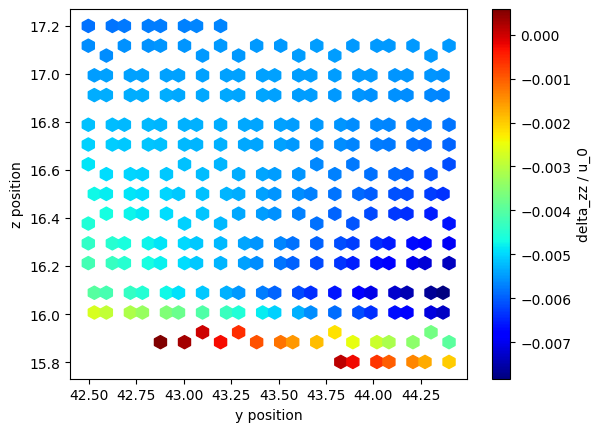

In [92]:
plt.hexbin(Y,Z, C=u_prime_prime * 1000 / u.mean(), gridsize=30, cmap=CM.jet)
cb = PLT.colorbar()
cb.set_label('delta_zz / u_0')
plt.xlabel('y position')
plt.ylabel('z position')